# **1. Perkenalan Dataset**


Tahap pertama, Anda harus mencari dan menggunakan dataset **tanpa label** dengan ketentuan sebagai berikut:

1. **Sumber Dataset**:  
   Dataset dapat diperoleh dari berbagai sumber, seperti public repositories (*Kaggle*, *UCI ML Repository*, *Open Data*) atau data primer yang Anda kumpulkan sendiri.
   
2. **Ketentuan Dataset**:
   - **Tanpa label**: Dataset tidak boleh memiliki label atau kelas.
   - **Jumlah Baris**: Minimal 1000 baris untuk memastikan dataset cukup besar untuk analisis yang bermakna.
   - **Tipe Data**: Harus mengandung data **kategorikal** dan **numerikal**.
     - *Kategorikal*: Misalnya jenis kelamin, kategori produk.
     - *Numerikal*: Misalnya usia, pendapatan, harga.

3. **Pembatasan**:  
   Dataset yang sudah digunakan dalam latihan clustering (seperti customer segmentation) tidak boleh digunakan.

In [1]:
#Type your code here
link_data = "https://www.kaggle.com/datasets/usgs/earthquake-database/data"

Dataset ini terdiri dari data-data gempa di seluruh belahan dunia. Kolom pada dataset ini terdiri dari:
* date, 
* time, 
* location (lat lon) 
* depth (km),
* type of earhquake 
* magnitude, 
* magnitude type,
* status
* etc

# **2. Import Library**

Pada tahap ini, Anda perlu mengimpor beberapa pustaka (library) Python yang dibutuhkan untuk analisis data dan pembangunan model machine learning.

In [2]:
import pandas as pd
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering  
from sklearn.metrics import silhouette_score 
from yellowbrick.cluster import KElbowVisualizer

import folium
import branca

print("Setup Complete")

Setup Complete


# **3. Memuat Dataset**

Pada tahap ini, Anda perlu memuat dataset ke dalam notebook. Jika dataset dalam format CSV, Anda bisa menggunakan pustaka pandas untuk membacanya. Pastikan untuk mengecek beberapa baris awal dataset untuk memahami strukturnya dan memastikan data telah dimuat dengan benar.

Jika dataset berada di Google Drive, pastikan Anda menghubungkan Google Drive ke Colab terlebih dahulu. Setelah dataset berhasil dimuat, langkah berikutnya adalah memeriksa kesesuaian data dan siap untuk dianalisis lebih lanjut.

In [3]:
raw_data = pd.read_csv('data/database.csv')

# **4. Exploratory Data Analysis (EDA)**

Pada tahap ini, Anda akan melakukan **Exploratory Data Analysis (EDA)** untuk memahami karakteristik dataset. EDA bertujuan untuk:

1. **Memahami Struktur Data**
   - Tinjau jumlah baris dan kolom dalam dataset.  
   - Tinjau jenis data di setiap kolom (numerikal atau kategorikal).

2. **Menangani Data yang Hilang**  
   - Identifikasi dan analisis data yang hilang (*missing values*). Tentukan langkah-langkah yang diperlukan untuk menangani data yang hilang, seperti pengisian atau penghapusan data tersebut.

3. **Analisis Distribusi dan Korelasi**  
   - Analisis distribusi variabel numerik dengan statistik deskriptif dan visualisasi seperti histogram atau boxplot.  
   - Periksa hubungan antara variabel menggunakan matriks korelasi atau scatter plot.

4. **Visualisasi Data**  
   - Buat visualisasi dasar seperti grafik distribusi dan diagram batang untuk variabel kategorikal.  
   - Gunakan heatmap atau pairplot untuk menganalisis korelasi antar variabel.

Tujuan dari EDA adalah untuk memperoleh wawasan awal yang mendalam mengenai data dan menentukan langkah selanjutnya dalam analisis atau pemodelan.

In [4]:
#Type your code here
raw_data.describe()

,Latitude,Longitude,Depth,Depth Error,Depth Seismic Stations,Magnitude,Magnitude Error,Magnitude Seismic Stations,Azimuthal Gap,Horizontal Distance,Horizontal Error,Root Mean Square
count,23412.000000,23412.000000,23412.000000,4461.000000,7097.000000,23412.000000,327.000000,2564.000000,7299.000000,1604.000000,1156.000000,17352.000000
mean,1.679033,39.639961,70.767911,4.993115,275.364098,5.882531,0.071820,48.944618,44.163532,3.992660,7.662759,1.022784
std,30.113183,125.511959,122.651898,4.875184,162.141631,0.423066,0.051466,62.943106,32.141486,5.377262,10.430396,0.188545
min,-77.080000,-179.997000,-1.100000,0.000000,0.000000,5.500000,0.000000,0.000000,0.000000,0.004505,0.085000,0.000000
25%,-18.653000,-76.349750,14.522500,1.800000,146.000000,5.600000,0.046000,10.000000,24.100000,0.968750,5.300000,0.900000
50%,-3.568500,103.982000,33.000000,3.500000,255.000000,5.700000,0.059000,28.000000,36.000000,2.319500,6.700000,1.000000
75%,26.190750,145.026250,54.000000,6.300000,384.000000,6.000000,0.075500,66.000000,54.000000,4.724500,8.100000,1.130000
max,86.005000,179.998000,700.000000,91.295000,934.000000,9.100000,0.410000,821.000000,360.000000,37.874000,99.000000,3.440000


In [5]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Date                        23412 non-null  object 
 1   Time                        23412 non-null  object 
 2   Latitude                    23412 non-null  float64
 3   Longitude                   23412 non-null  float64
 4   Type                        23412 non-null  object 
 5   Depth                       23412 non-null  float64
 6   Depth Error                 4461 non-null   float64
 7   Depth Seismic Stations      7097 non-null   float64
 8   Magnitude                   23412 non-null  float64
 9   Magnitude Type              23409 non-null  object 
 10  Magnitude Error             327 non-null    float64
 11  Magnitude Seismic Stations  2564 non-null   float64
 12  Azimuthal Gap               7299 non-null   float64
 13  Horizontal Distance         160

In [6]:
data = raw_data[['Date', 'Time', 'Latitude', 'Longitude', 'Type', 'Depth', 'Magnitude', 'Magnitude Type', 'Status']]

### Check & Fix Missing Values

In [7]:
missing_data = data.isnull().sum()
print(f"Columns with missing values:\n {missing_data[missing_data > 0]}")

Columns with missing values:
 Magnitude Type    3
dtype: int64


In [8]:
data = data.dropna()

### Check & Fix Date Type

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23409 entries, 0 to 23411
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Date            23409 non-null  object 
 1   Time            23409 non-null  object 
 2   Latitude        23409 non-null  float64
 3   Longitude       23409 non-null  float64
 4   Type            23409 non-null  object 
 5   Depth           23409 non-null  float64
 6   Magnitude       23409 non-null  float64
 7   Magnitude Type  23409 non-null  object 
 8   Status          23409 non-null  object 
dtypes: float64(4), object(5)
memory usage: 1.8+ MB


### Check & Fix Inconsistent Values

#### Date column

In [10]:
date_lengths = data.Date.str.len()
date_lengths.value_counts()

Date
10    23406
24        3
Name: count, dtype: int64

In [11]:
indices = np.where([date_lengths ==24])[1]
data.loc[indices]

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status
3378,1975-02-23T02:58:41.000Z,1975-02-23T02:58:41.000Z,8.017,124.075,Earthquake,623.0,5.6,MB,Reviewed
7510,04/27/1985,01:31:28,38.599,73.173,Earthquake,104.0,5.6,MW,Reviewed
20647,03/12/2011,22:12:46,37.681,141.889,Earthquake,16.0,5.8,MWW,Reviewed


In [12]:
data.loc[3378, "Date"] = "02/23/1975"
data.loc[7512, "Date"] = "04/28/1985"
data.loc[20650, "Date"] = "03/13/2011"

In [13]:
data.loc[[3378,7512,20650]]

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status
3378,02/23/1975,1975-02-23T02:58:41.000Z,8.017,124.075,Earthquake,623.0,5.6,MB,Reviewed
7512,04/28/1985,1985-04-28T02:53:41.530Z,-32.998,-71.766,Earthquake,33.0,5.6,MW,Reviewed
20650,03/13/2011,2011-03-13T02:23:34.520Z,36.344,142.344,Earthquake,10.1,5.8,MWC,Reviewed


In [14]:
data['Date'] = pd.to_datetime(data['Date'])
data = data.set_index('Date')
data = data.drop('Time',axis=1)
data.head(3)

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status
Date,,,,,,,
1965-01-02,19.246,145.616,Earthquake,131.6,6.0,MW,Automatic
1965-01-04,1.863,127.352,Earthquake,80.0,5.8,MW,Automatic
1965-01-05,-20.579,-173.972,Earthquake,20.0,6.2,MW,Automatic


#### Earthquake Type Column

In [15]:
data.Type.value_counts()

Type
Earthquake           23229
Nuclear Explosion      175
Explosion                4
Rock Burst               1
Name: count, dtype: int64

In [16]:
data = data[data['Type'] == 'Earthquake']
data.Type.value_counts()

Type
Earthquake    23229
Name: count, dtype: int64

#### Depth Column

In [17]:
data[data['Depth'] < 0]

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status
Date,,,,,,,
1986-07-21,37.621333,-118.3425,Earthquake,-0.076,5.60,ML,Reviewed
1992-06-28,34.200000,-116.4370,Earthquake,-0.097,7.30,MW,Reviewed
1992-06-28,34.131000,-116.4080,Earthquake,-1.100,5.77,ML,Reviewed


In [18]:
data = data[data['Depth'] > 0]

### Separate Numerical & Categorical Features

In [19]:
data_num = data.select_dtypes(include = ['float64', 'int64'])
data_num.sample(2)

,Latitude,Longitude,Depth,Magnitude
Date,,,,
2006-06-16,1.281,121.799,25.7,5.6
1974-02-01,-7.121,155.074,48.0,5.6


In [20]:
data_cat = pd.DataFrame()
data_cat['Magnitude Type'] = pd.Categorical(data['Magnitude Type'])
data_cat['Status'] = pd.Categorical(data['Status'])
data_cat.sample(2)

data['Magnitude Type'] = pd.Categorical(data['Magnitude Type'])
data['Status'] = pd.Categorical(data['Status'])

### Analysis

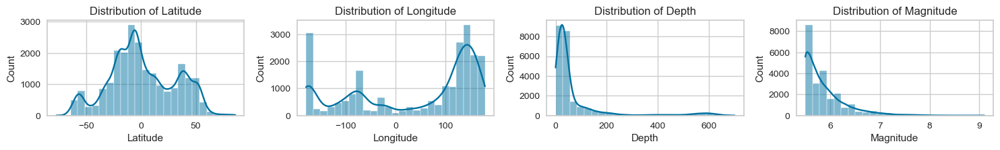

In [21]:
num_columns = ['Latitude', 'Longitude', 'Depth', 'Magnitude',]
plt.figure(figsize=(15,6))
for i, feature in enumerate (data[num_columns],1):
    plt.subplot(3,4,i)
    sns.histplot(data[feature], bins=25, kde=True)
    plt.title(f'Distribution of {feature}')
plt.tight_layout()
plt.show()

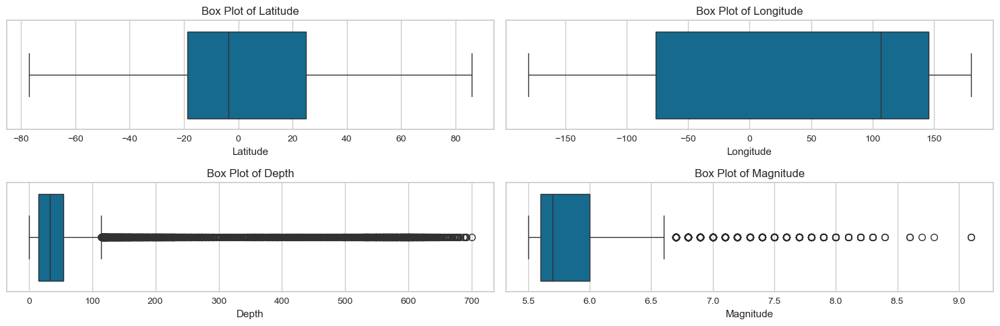

In [22]:
# Box Plot
fig, ax = plt.subplots(ncols=2, nrows=2,figsize=(15, 5))
ax = ax.flatten()
for x, col in enumerate(num_columns):
    sns.boxplot(x=data[col], ax=ax[x])
    ax[x].set_title(f'Box Plot of {col}')
plt.tight_layout()
plt.show()


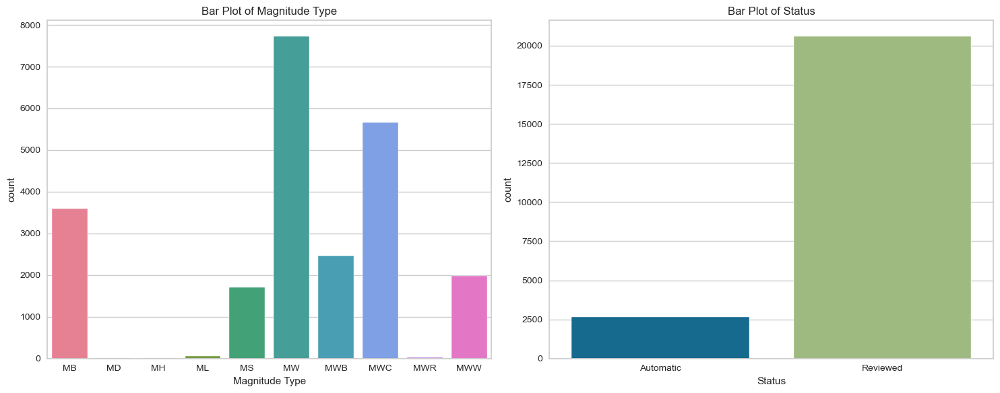

In [23]:
# Bar Plot
cat_columns = ['Magnitude Type', 'Status']
fig, ax = plt.subplots(ncols=2, nrows=1,figsize=(15, 6))
ax = ax.flatten()
for x, col in enumerate(cat_columns):
    sns.countplot(x=data[col], ax=ax[x], hue=data[col])
    ax[x].set_title(f'Bar Plot of {col}')
plt.tight_layout()
plt.show()

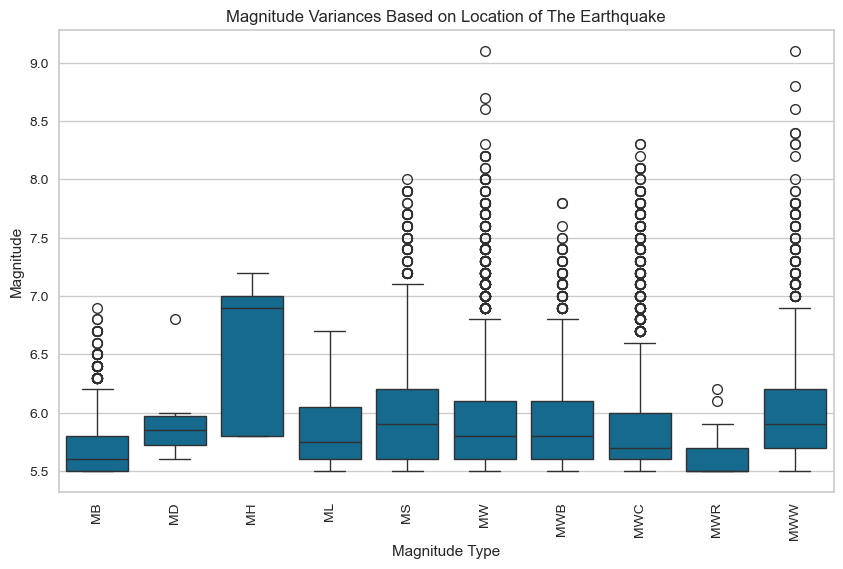

In [24]:
plt.figure(figsize=(10,6))
sns.boxplot(data=data, x="Magnitude Type", y="Magnitude")
plt.title("Magnitude Variances Based on Location of The Earthquake")
plt.xticks(rotation=90)
plt.show()

In [ ]:
high_magnitude = [7, 8, 9]
for threshold in high_magnitude:
    count_true = (data['Magnitude'] > threshold).sum() 
    print(f'Magnitude > {threshold}: {count_true}')

Magnitude > 7: 569
Magnitude > 8: 27
Magnitude > 9: 2


In [26]:
data[data['Magnitude'] > 9]

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status
Date,,,,,,,
2004-12-26,3.295,95.982,Earthquake,30.0,9.1,MW,Reviewed
2011-03-11,38.297,142.373,Earthquake,29.0,9.1,MWW,Reviewed


In [27]:
data_num_corr = data_num.corr()['Magnitude'] 
data_num_corr

Latitude     0.034664
Longitude    0.037499
Depth        0.023251
Magnitude    1.000000
Name: Magnitude, dtype: float64

<Axes: >

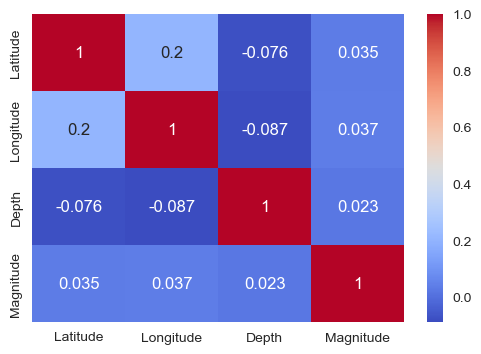

In [28]:
plt.figure(figsize=(6, 4))
sns.heatmap(data_num.corr(), annot=True, cmap='coolwarm')

<Figure size 1200x1200 with 0 Axes>

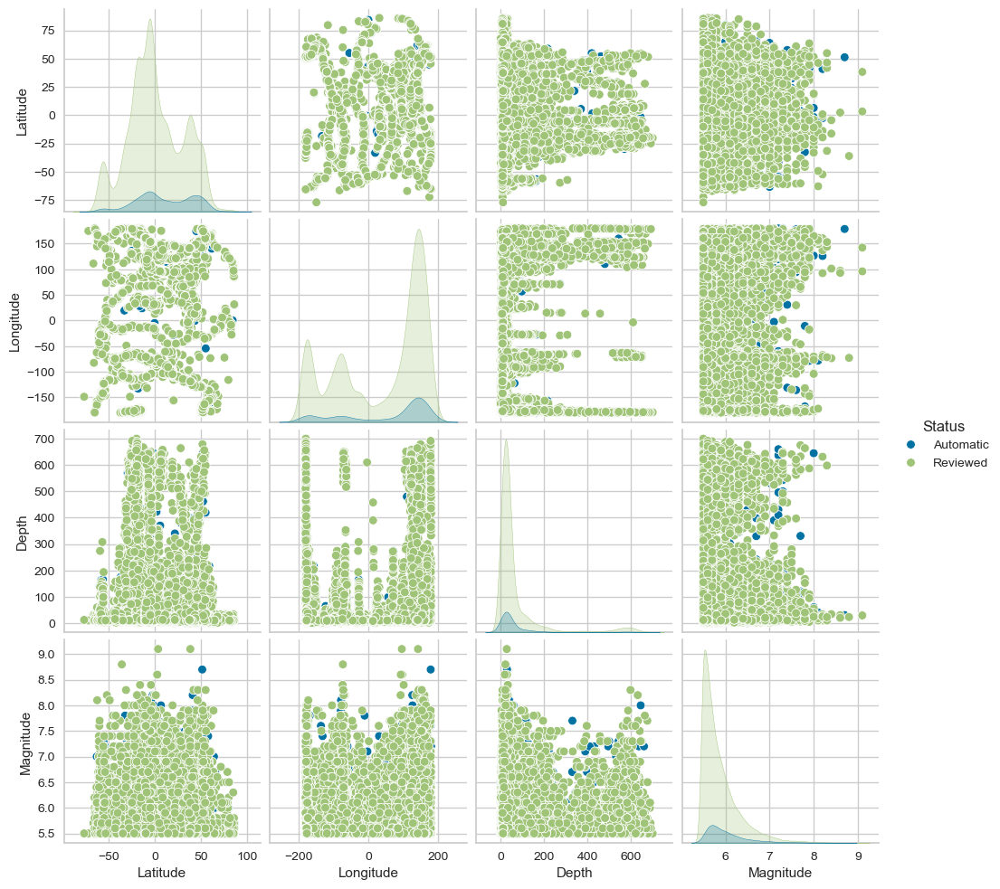

In [29]:
# Pairplot
plt.figure(figsize=(12,12))
sns.pairplot(data, hue='Status')

In [30]:
m = folium.Map(location=[20, 0], zoom_start=2)
data_high_magnitude = data[['Latitude', 'Longitude', 'Magnitude']]
data_high_magnitude = data[data['Magnitude'] > 7]

def get_magnitude_color(magnitude):
    if magnitude >= 9:
        return 'red' 
    elif magnitude >= 8:
        return 'cyan'  
    elif magnitude >= 7:
        return 'blue'  

for index, row in data_high_magnitude.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    mag = row['Magnitude']
    color = get_magnitude_color(mag)

    folium.CircleMarker(
        location=[lat, lon],
        radius=3,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=f'Magnitude: {mag}',
    ).add_to(m)

m

Terdapat outlier dari pairplot menunjukkan adanya data ekstrem, terutama pada hubungan antara 'Magnitude' dan variabel lainnya.

Distribusi data 'Magnitude' dan 'Depth' tampaknya tidak terdistribusi merata (Positive Skewed). Ini berarti sebagian besar nilai cenderung kecil dan nilai besar cenderung sedikit

Untuk membuat data lebih dapat diprediksi dan cocok untuk analisis, kita perlu mempertimbangkan untuk mentransformasikan variabel-variabel tsb agar lebih mendekati distribusi normal. Hal ini dapat mengurangi pengaruh nilai-nilai besar dan membuat data lebih mudah dikelola.

Untuk melakukan penskalaan data agar semua variabel dapat dibandingkan secara rata. Teknik seperti StandardScaler atau MinmaxScaler bisa digunakan untuk tujuan ini.

# **5. Data Preprocessing**

Pada tahap ini, data preprocessing adalah langkah penting untuk memastikan kualitas data sebelum digunakan dalam model machine learning. Data mentah sering kali mengandung nilai kosong, duplikasi, atau rentang nilai yang tidak konsisten, yang dapat memengaruhi kinerja model. Oleh karena itu, proses ini bertujuan untuk membersihkan dan mempersiapkan data agar analisis berjalan optimal.

Berikut adalah tahapan-tahapan yang perlu dilakukan, namun **tidak terbatas** pada:
1. Menghapus atau Menangani Data Kosong (Missing Values)
2. Menghapus Data Duplikat
3. Normalisasi atau Standarisasi Fitur
4. Deteksi dan Penanganan Outlier
5. Encoding Data Kategorikal
6. Binning (Pengelompokan Data)

### Fix Duplicate Value

In [31]:
data.duplicated().sum()

2

In [32]:
data = data.drop_duplicates()

### Fix Outliers

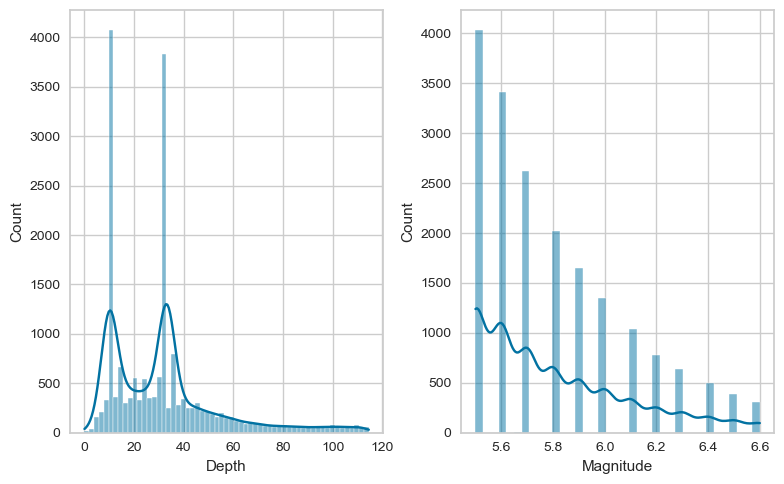

In [33]:
Q1 = data_num.quantile(0.25)
Q3 = data_num.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = (data_num < lower_bound) | (data_num > upper_bound)

cleaned_data = data_num[~outliers.any(axis=1)]

fig, ax = plt.subplots(ncols=2, nrows=1, figsize=(8, 5))
ax = ax.flatten()
sns.histplot(cleaned_data['Depth'], kde=True, ax=ax[0])
sns.histplot(cleaned_data['Magnitude'], kde=True, ax=ax[1])
plt.tight_layout()
plt.show()

In [ ]:
cleaned_data = cleaned_data.dropna()

In [35]:
# Backup data if something goes wrong
unaltered_data = data.copy()

### Normalization Data Using Log Transformation

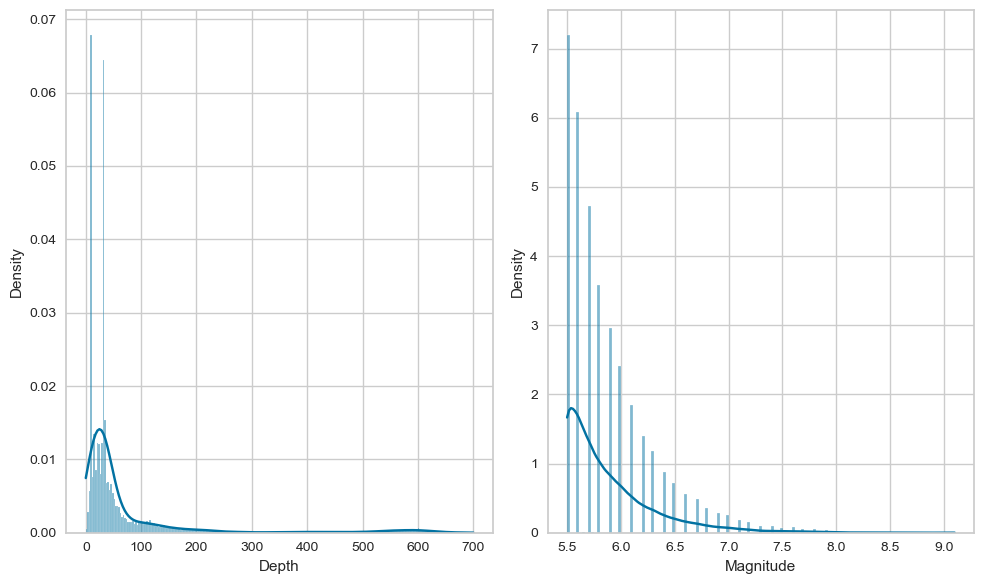

In [36]:
fig, ax = plt.subplots(ncols=2, nrows=1,figsize=(10,6))
ax = ax.flatten()
sns.histplot(data['Depth'], kde=True, stat="density", ax=ax[0])
sns.histplot(data['Magnitude'], kde=True, stat="density", ax=ax[1])
plt.tight_layout()
plt.show()

C:\Users\Doni\AppData\Local\Temp\ipykernel_1816\1093427670.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Depth'] = np.log(data['Depth'] + 1) # +1 agar nilai hasilnya selalu positif
C:\Users\Doni\AppData\Local\Temp\ipykernel_1816\1093427670.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Magnitude'] = np.log(data['Magnitude'])


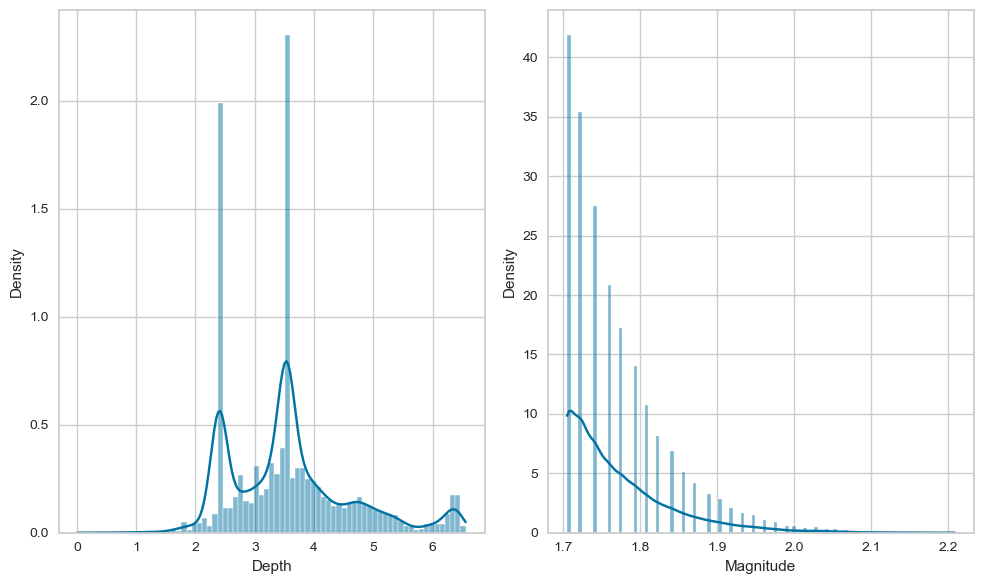

In [37]:
data['Depth'] = np.log(data['Depth'] + 1) # +1 agar nilai hasilnya selalu positif
data['Magnitude'] = np.log(data['Magnitude'])

fig, ax = plt.subplots(ncols=2, nrows=1,figsize=(10,6))
ax = ax.flatten()
sns.histplot(data['Depth'], kde=True, stat="density", ax=ax[0])
sns.histplot(data['Magnitude'], kde=True, stat="density", ax=ax[1])
plt.tight_layout()
plt.show()

### Standardization

In [38]:
scaler = StandardScaler()
data[['Magnitude', 'Depth']] = scaler.fit_transform(data[['Magnitude', 'Depth']])

C:\Users\Doni\AppData\Local\Temp\ipykernel_1816\3286497324.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[['Magnitude', 'Depth']] = scaler.fit_transform(data[['Magnitude', 'Depth']])


### One Hot Encoding

In [39]:
data = pd.get_dummies(data=data,drop_first=True,dtype='i')
data.sample(2)

,Latitude,Longitude,Depth,Magnitude,Magnitude Type_MD,Magnitude Type_MH,Magnitude Type_ML,Magnitude Type_MS,Magnitude Type_MW,Magnitude Type_MWB,Magnitude Type_MWC,Magnitude Type_MWR,Magnitude Type_MWW,Status_Reviewed
Date,,,,,,,,,,,,,,
2002-07-11,24.075,122.288,0.207184,-0.172598,0,0,0,0,0,0,1,0,0,1
2013-07-02,-23.851,-66.516,1.636283,-0.687580,0,0,0,0,0,0,0,0,1,1


# **6. Pembangunan Model Clustering**

## **a. Pembangunan Model Clustering**

Pada tahap ini, Anda membangun model clustering dengan memilih algoritma yang sesuai untuk mengelompokkan data berdasarkan kesamaan. Berikut adalah **rekomendasi** tahapannya.
1. Pilih algoritma clustering yang sesuai.
2. Latih model dengan data menggunakan algoritma tersebut.

### Elbow Method

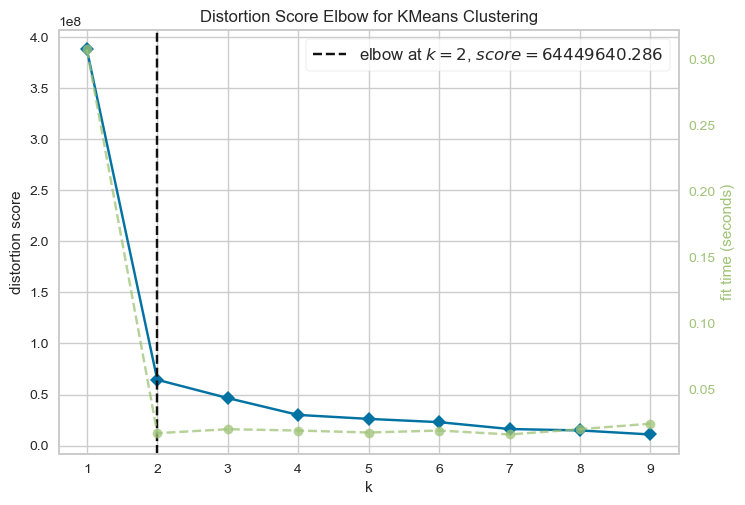

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [40]:
# Elbow Method
kmeans = KMeans()
# Menghitung Sum of Square Errors (SSE)
# Inisialisasi visualizer KElbow untuk menentukan jumlah cluster optimal
visualizer = KElbowVisualizer(kmeans, k=(1, 10))
 
# Fit visualizer dengan data untuk menemukan jumlah cluster optimal
visualizer.fit(data)
 
# Menampilkan grafik elbow untuk analisis
visualizer.show()

### K-Means

Silhouette Score for k=6: 0.4732197036243399


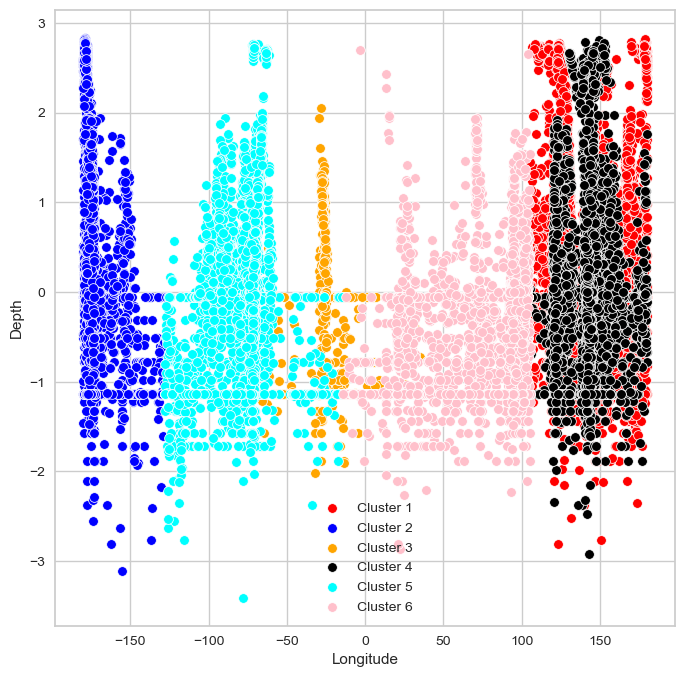

In [41]:
# K-Means
k=6
km = KMeans(n_clusters = k, random_state=42)
prediction_km = km.fit_predict(data)
prediction_km.shape

plt.figure(figsize=(8,8))
sns.scatterplot(data=data, x=data.iloc[prediction_km == 0,1] , y=data.iloc[prediction_km == 0,2],color='red', label = 'Cluster 1');
sns.scatterplot(data=data, x=data.iloc[prediction_km == 1,1] , y=data.iloc[prediction_km == 1,2],color='blue', label = 'Cluster 2');
sns.scatterplot(data=data, x=data.iloc[prediction_km == 2,1] , y=data.iloc[prediction_km == 2,2],color='orange',  label = 'Cluster 3');
sns.scatterplot(data=data, x=data.iloc[prediction_km == 3,1] , y=data.iloc[prediction_km == 3,2],color='black',  label = 'Cluster 4');
sns.scatterplot(data=data, x=data.iloc[prediction_km == 4,1] , y=data.iloc[prediction_km == 4,2],color='cyan',  label = 'Cluster 5');
sns.scatterplot(data=data, x=data.iloc[prediction_km == 5,1] , y=data.iloc[prediction_km == 5,2],color='pink',  label = 'Cluster 6');


score = silhouette_score(data, prediction_km)
print(f"Silhouette Score for k={k}: {score}")

### DBSCAN

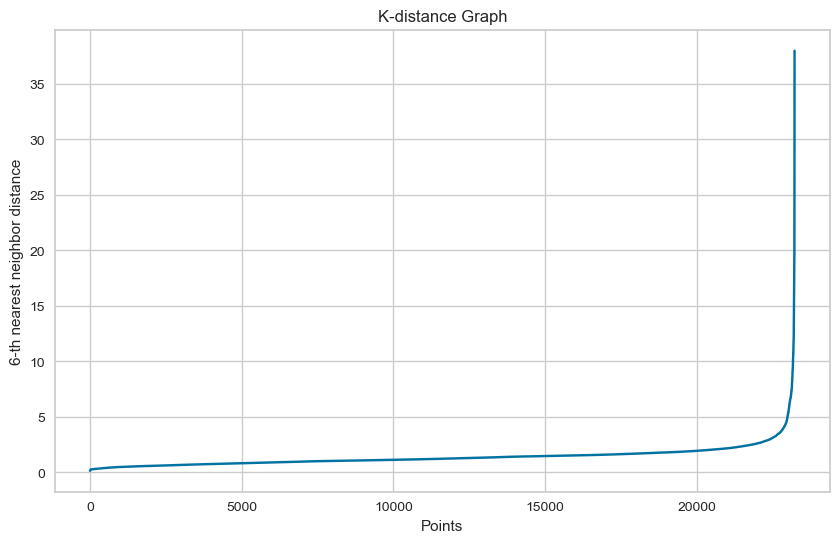

In [42]:
from sklearn.neighbors import NearestNeighbors
def plot_k_distance_graph(X, k):
    neigh = NearestNeighbors(n_neighbors=k)
    neigh.fit(X)
    distances, _ = neigh.kneighbors(X)
    distances = np.sort(distances[:, k-1])
    plt.figure(figsize=(10, 6))
    plt.plot(distances)
    plt.xlabel('Points')
    plt.ylabel(f'{k}-th nearest neighbor distance')
    plt.title('K-distance Graph')
    plt.show()

plot_k_distance_graph(data, k=6)

In [43]:
# 2. DBSCAN Clustering
for x in range(10, 31):
    dbscan = DBSCAN(eps=x, min_samples=300, metric='euclidean', algorithm='auto')
    prediction_db = dbscan.fit_predict(data)
    score = silhouette_score(data, prediction_db)
    print(f'score dengan nilai eps {x} adalah {score} dan jumlah kluster = {np.unique(prediction_db)}')


score dengan nilai eps 10 adalah 0.3738968091348912 dan jumlah kluster = [-1  0  1  2  3  4  5]
score dengan nilai eps 11 adalah 0.3882101463794416 dan jumlah kluster = [-1  0  1  2  3  4  5]
score dengan nilai eps 12 adalah 0.48870386336310934 dan jumlah kluster = [-1  0  1  2  3  4  5]
score dengan nilai eps 13 adalah 0.35883255545058657 dan jumlah kluster = [-1  0  1  2  3  4  5  6]
score dengan nilai eps 14 adalah 0.3688356504151788 dan jumlah kluster = [-1  0  1  2  3  4  5  6]
score dengan nilai eps 15 adalah 0.3737094102232876 dan jumlah kluster = [-1  0  1  2  3  4  5  6]
score dengan nilai eps 16 adalah 0.6060168086932459 dan jumlah kluster = [-1  0  1  2  3  4]
score dengan nilai eps 17 adalah 0.5737547532387501 dan jumlah kluster = [-1  0  1  2  3  4  5]
score dengan nilai eps 18 adalah 0.6089950114907039 dan jumlah kluster = [-1  0  1  2  3  4]
score dengan nilai eps 19 adalah 0.5551021124981254 dan jumlah kluster = [-1  0  1  2  3]
score dengan nilai eps 20 adalah 0.557894

In [44]:
dbscan = DBSCAN(eps=18, min_samples=300, metric='euclidean', algorithm='auto')
prediction_db = dbscan.fit_predict(data)
score = silhouette_score(data, prediction_db)
print(f'score dengan nilai eps {18} adalah {score}')

score dengan nilai eps 18 adalah 0.6089950114907039


### Agglomerative Clustering

0.5011810946103182


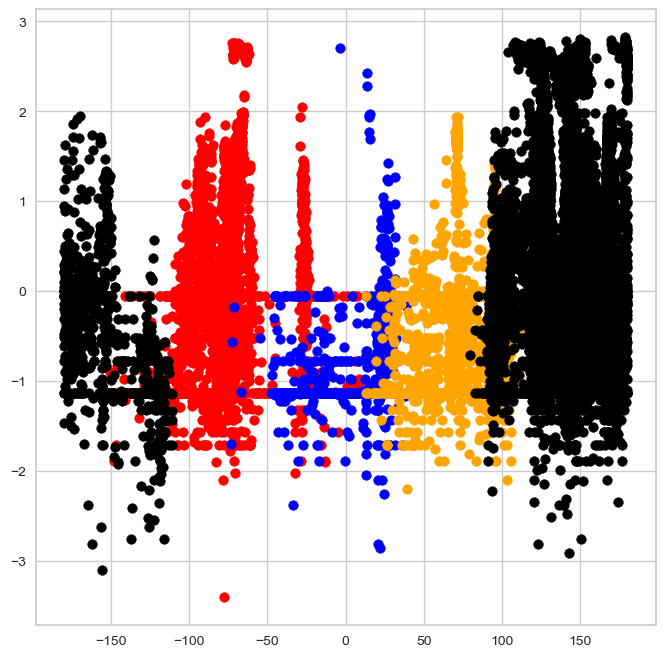

In [45]:
n_cluster = 6
agg_clust = AgglomerativeClustering(n_clusters=n_cluster, metric='euclidean', linkage='average')
prediction_agg_clust = agg_clust.fit_predict(data)
score = silhouette_score(data, prediction_agg_clust)
print(score)

plt.figure(figsize = (8,8))
plt.scatter(data.iloc[prediction_agg_clust == 0,1] , data.iloc[prediction_agg_clust == 0,2],color='red', label = 'Cluster 1');
plt.scatter(data.iloc[prediction_agg_clust == 1,1] , data.iloc[prediction_agg_clust == 1,2],color='blue', label = 'Cluster 2');
plt.scatter(data.iloc[prediction_agg_clust == 2,1] , data.iloc[prediction_agg_clust == 2,2],color='orange',  label = 'Cluster 3');
plt.scatter(data.iloc[prediction_agg_clust == 3,1] , data.iloc[prediction_agg_clust == 3,2],color='black',  label = 'Cluster 4');
plt.scatter(data.iloc[prediction_agg_clust == 4,1] , data.iloc[prediction_agg_clust == 4,2],color='black',  label = 'Cluster 5');
plt.show()

## **b. Evaluasi Model Clustering**

Untuk menentukan jumlah cluster yang optimal dalam model clustering, Anda dapat menggunakan metode Elbow atau Silhouette Score.

Metode ini membantu kita menemukan jumlah cluster yang memberikan pemisahan terbaik antar kelompok data, sehingga model yang dibangun dapat lebih efektif. Berikut adalah **rekomendasi** tahapannya.
1. Gunakan Silhouette Score dan Elbow Method untuk menentukan jumlah cluster optimal.
2. Hitung Silhouette Score sebagai ukuran kualitas cluster.

In [46]:
# Data must have 6 cluster
score_km = silhouette_score(data, prediction_km)
print(f"Silhouette Score with K-Means k={k}: {score_km}")
score_db = silhouette_score(data, prediction_db)
print(f"Silhouette Score with DBSCAN: {score_db}")
score_agg = silhouette_score(data, prediction_agg_clust)
print(f"Silhouette Score with AGG CLustering for n={n_cluster}: {score_agg}")

Silhouette Score with K-Means k=6: 0.4732197036243399
Silhouette Score with DBSCAN: 0.6089950114907039
Silhouette Score with AGG CLustering for n=6: 0.5011810946103182


## **c. Feature Selection (Opsional)**

Silakan lakukan feature selection jika Anda membutuhkan optimasi model clustering. Jika Anda menerapkan proses ini, silakan lakukan pemodelan dan evaluasi kembali menggunakan kolom-kolom hasil feature selection. Terakhir, bandingkan hasil performa model sebelum dan sesudah menerapkan feature selection.

## **d. Visualisasi Hasil Clustering**

Setelah model clustering dilatih dan jumlah cluster optimal ditentukan, langkah selanjutnya adalah menampilkan hasil clustering melalui visualisasi.

Berikut adalah **rekomendasi** tahapannya.
1. Tampilkan hasil clustering dalam bentuk visualisasi, seperti grafik scatter plot atau 2D PCA projection.

### 3d Visualization

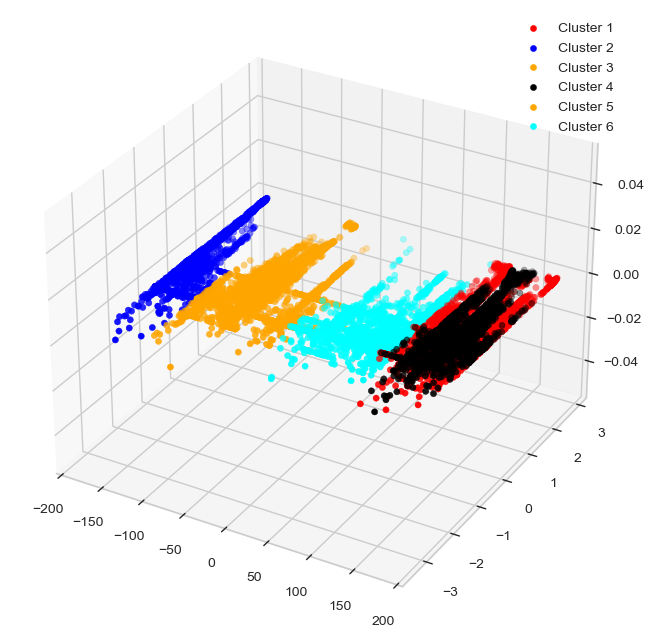

In [47]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data.iloc[prediction_km == 0,1] , data.iloc[prediction_km == 0,2],color='red', label = 'Cluster 1');
ax.scatter(data.iloc[prediction_km == 1,1] , data.iloc[prediction_km == 1,2],color='blue', label = 'Cluster 2');
ax.scatter(data.iloc[prediction_km == 2,1] , data.iloc[prediction_km == 2,2],color='orange',  label = 'Cluster 3');
ax.scatter(data.iloc[prediction_km == 3,1] , data.iloc[prediction_km == 3,2],color='black',  label = 'Cluster 4');
ax.scatter(data.iloc[prediction_km == 4,1] , data.iloc[prediction_km == 4,2],color='orange',  label = 'Cluster 5');
ax.scatter(data.iloc[prediction_km == 5,1] , data.iloc[prediction_km == 5,2],color='cyan',  label = 'Cluster 6');

ax.legend()
plt.show()

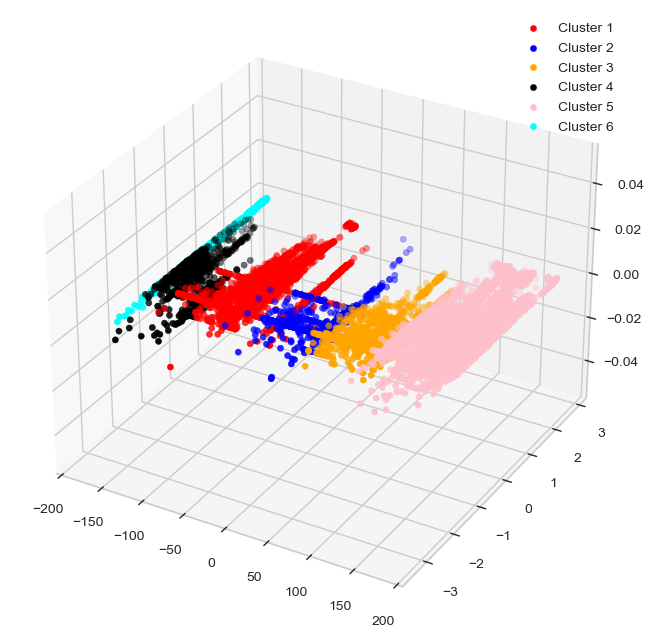

In [48]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data.iloc[prediction_agg_clust == 0,1] , data.iloc[prediction_agg_clust == 0,2],color='red', label = 'Cluster 1');
ax.scatter(data.iloc[prediction_agg_clust == 1,1] , data.iloc[prediction_agg_clust == 1,2],color='blue', label = 'Cluster 2');
ax.scatter(data.iloc[prediction_agg_clust == 2,1] , data.iloc[prediction_agg_clust == 2,2],color='orange',  label = 'Cluster 3');
ax.scatter(data.iloc[prediction_agg_clust == 3,1] , data.iloc[prediction_agg_clust == 3,2],color='black',  label = 'Cluster 4');
ax.scatter(data.iloc[prediction_agg_clust == 4,1] , data.iloc[prediction_agg_clust == 4,2],color='pink',  label = 'Cluster 5');
ax.scatter(data.iloc[prediction_agg_clust == 5,1] , data.iloc[prediction_agg_clust == 5,2],color='cyan',  label = 'Cluster 6');
ax.legend()
plt.show()

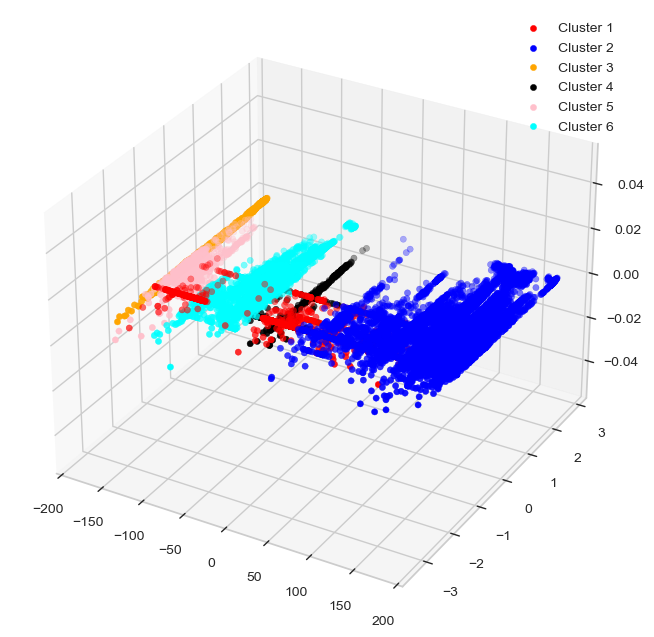

In [49]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data.iloc[prediction_db == -1,1] , data.iloc[prediction_db  == -1,2],color='red', label = 'Cluster 1');
ax.scatter(data.iloc[prediction_db  == 0,1] , data.iloc[prediction_db   == 0,2],color='blue', label = 'Cluster 2');
ax.scatter(data.iloc[prediction_db  == 1,1] , data.iloc[prediction_db  == 1,2],color='orange',  label = 'Cluster 3');
ax.scatter(data.iloc[prediction_db  == 2,1] , data.iloc[prediction_db  == 2,2],color='black',  label = 'Cluster 4');
ax.scatter(data.iloc[prediction_db  == 3,1] , data.iloc[prediction_db  == 3,2],color='pink',  label = 'Cluster 5');
ax.scatter(data.iloc[prediction_db  == 4,1] , data.iloc[prediction_db  == 4,2],color='cyan',  label = 'Cluster 6');

ax.legend()
plt.show()

### 2D

#### PCA Projection

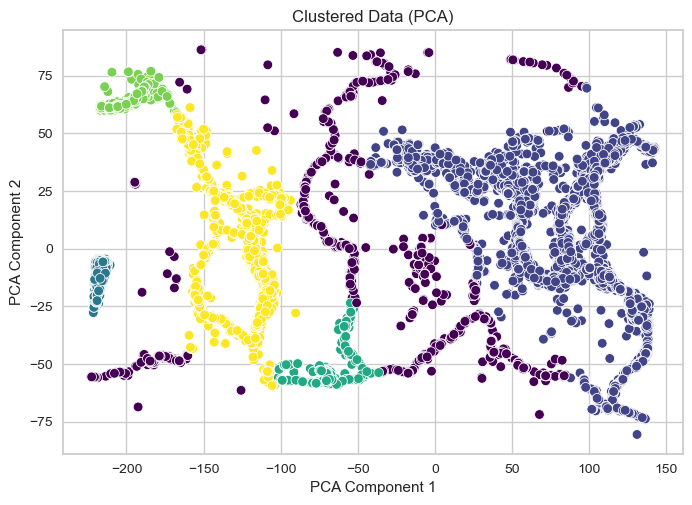

In [50]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca_components = pca.fit_transform(data)

import matplotlib.pyplot as plt
sns.scatterplot(data=data, x=pca_components[:, 0], y=pca_components[:, 1], c=prediction_db, cmap='viridis', legend=True)
plt.title('Clustered Data (PCA)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.show()

#### Plot scatter

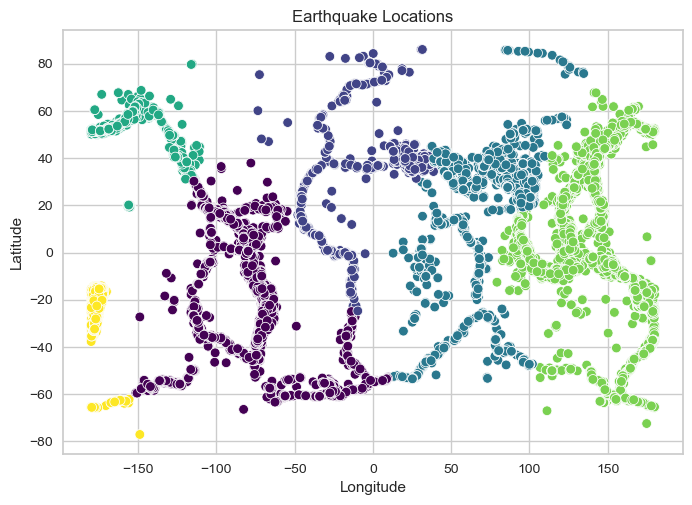

In [51]:
import matplotlib.pyplot as plt

sns.scatterplot(data=data, x=data['Longitude'], y=data['Latitude'], c=prediction_agg_clust, cmap='viridis', legend=True)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Earthquake Locations')
plt.show()

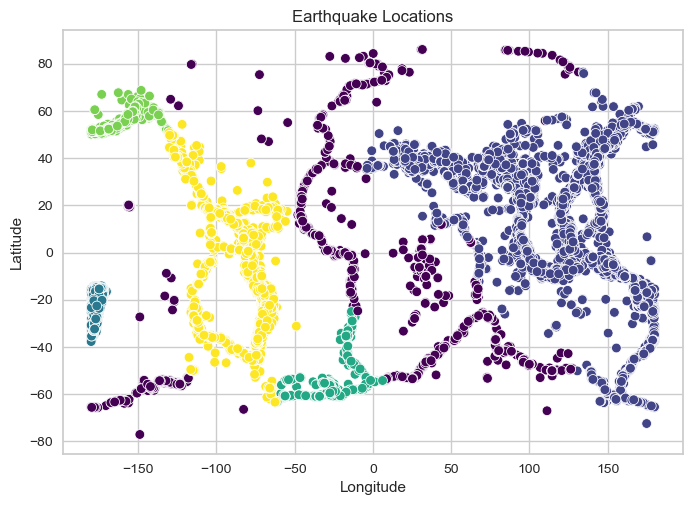

In [52]:
import matplotlib.pyplot as plt

sns.scatterplot(data=data, x=data['Longitude'], y=data['Latitude'], c=prediction_db, cmap='viridis', legend=True)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Earthquake Locations')
plt.show()

### Map Visualizations by Cluster

In [53]:
data['Cluster'] = prediction_db

In [54]:
import folium
import branca

cluster_colors = { 
    -1: 'blue',
    0: 'green',
    1: 'red',
    2: 'purple',
    3: 'orange',
    4: 'pink',
    5: 'cyan'
}

m = folium.Map(location=[0, 0], zoom_start=2)

for index, row in data.iterrows():
    lat, lon, magnitude, cluster = row['Latitude'], row['Longitude'], row['Magnitude'], row['Cluster']
        
    folium.CircleMarker(
        location=[lat, lon],
        radius=1,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"Cluster: {cluster}, Magnitude: {magnitude}"
    ).add_to(m)

m

## **e. Analisis dan Interpretasi Hasil Cluster**

Setelah melakukan clustering, langkah selanjutnya adalah menganalisis karakteristik dari masing-masing cluster berdasarkan fitur yang tersedia.

Berikut adalah **rekomendasi** tahapannya.
1. Analisis karakteristik tiap cluster berdasarkan fitur yang tersedia (misalnya, distribusi nilai dalam cluster).
2. Berikan interpretasi: Apakah hasil clustering sesuai dengan ekspektasi dan logika bisnis? Apakah ada pola tertentu yang bisa dimanfaatkan?

Algoritma Clustering yang digunakan untuk tahap selanjutnya, yaitu Classification adalah **algoritma DBSCAN**, karena algoritma ini cocok untuk data geospasial

In [55]:
cluster_data = unaltered_data.copy()
cluster_data['Cluster'] = prediction_db
cluster_data.sample()

,Latitude,Longitude,Type,Depth,Magnitude,Magnitude Type,Status,Cluster
Date,,,,,,,,
2000-10-11,23.866,94.863,Earthquake,116.5,5.6,MWC,Reviewed,0


In [56]:
cluster_stats = cluster_data.groupby('Cluster').agg({
    'Magnitude': ['min', 'max', 'mean'],
    'Depth': ['min', 'max', 'mean']
})

cluster_stats[('magnitude_range')] = cluster_stats[('Magnitude', 'max')] - cluster_stats[('Magnitude', 'min')]
cluster_stats[('depth_range')] = cluster_stats[('Depth', 'max')] - cluster_stats[('Depth', 'min')]
cluster_stats['Value_count'] = cluster_data['Cluster'].value_counts()

Cluster -1 (biru):

- Memiliki jumlah titik gempa yaitu 1363.
- Rentang _magnitude_ 5.5-7.9 dengan rata-rata 5.82, paling rendah dibanding cluster lain. Hal ini diakibatkan interaksi antar lempeng itu divergen, sehingga tidak terlalu mengakibatkan gempa dengan _magnitude_ besar.
- Kedalaman gempa dangkal, 1.3-50 km dengan rata-rata 12.46 km.
- Terletak di sepanjang _Mid-Atlantic Ridge_ (MAR), beberapa titik di Afrika tengah-selatan, tenggara Selandia Baru, dan di _Pasifik-Atlantik Ridge_.
- Kemungkinan merupakan gempa intraplate yang terjadi dengan aktivitas vulkanik dan pergerakan lempeng di punggungan tengah samudera (_mid-oceanic ridges_) seperti MAR dan Pasifik-Atlantik Ridge dengan interaksi antar lempeng yaitu divergen/transfrom. Bisa juga terjadi di lempeng tektonik akibat patahan lokal atau _hot spot activity_ seperti di Hawaii.

Cluster 0 (hijau):

- Memiliki jumlah titik gempa terbanyak yaitu 14054. Hal ini disebabkan interaksi antar lempeng yaitu dominan konvergen dan transform, sehingga aktivitas gempa lebih mudah terjadi.
- Rentang magnitude lebar 5.5-9.1 dengan rata-rata 5.90. Magnitude 9.1 merupakan gempa Aceh 2004.
- Kedalaman gempa bervariasi dari dangkal hingga menengah (0.7-691.6 km) dengan rata-rata 67.62 km.
- Tersebar merata di seluruh benua Asia, Australia, dan sepanjang Cincin Api Pasifik.
- Mencakup gempa akibat berbagai mekanisme seperti subduksi yang dominan, patahan transform/strike-slip, dan rifting yang sedikit.

Cluster 1 (merah):

- Jumlah titik gempa cukup banyak (2578).
- Rentang magnitude 5.5-8.1 dengan rata-rata 5.83.
- Memiliki gempa paling dalam (rata-rata 162.7 km) dibanding cluster lain.
- Terletak di timur Australia dan di atas Selandia Baru.
- Gempa di timur Australia mungkin terkait dengan zona subduksi Lempeng Pasifik yang menunjam di bawah Lempeng Indo-Australia dan kemungkinan disebabkan sesar mendatar (strike-slip fault) seperti Alpine Fault.

Cluster 2 (ungu):

- Jumlah titik gempa paling sedikit (719).
- Rentang magnitude 5.5-7.7 dengan rata-rata 5.82.
- Kedalaman gempa menengah dengan rata-rata 36.65 km.
- Terletak di wilayah Lempeng Scotia, yang berada di antara Amerika Selatan dan Antartika.
- Gempa di cluster ini terkait dengan batas lempeng konvergen dan divergen di sekitar Lempeng Scotia. Selain itu zona subduksi Sandwich Selatan dan punggungan Scotia, yang dimana zona tersebut paling banyak titik gempa.

Cluster 3 (oranye):

- Jumlah titik gempa sedikit lebih banyak dari Cluster 2 (779).
- Rentang magnitude 5.5-8.0 dengan rata-rata 5.90.
- Kedalaman gempa menengah dengan rata-rata 38.1 km.
- Terletak di Alaska dan barat laut Kanada.
- Gempa di cluster ini disebabkan oleh zona subduksi Lempeng Pasifik yang menunjam di bawah Lempeng Amerika Utara, membentuk Aleutian megathrust.
- Selain itu, terdapat juga patahan transform seperti Queen Charlotte Fault di barat laut Kanada yang berkontribusi pada aktivitas seismik.

Cluster 4 (merah muda):

- Jumlah titik gempa signifikan (3727).
- Rentang magnitude paling lebar 5.5-8.8 dengan rata-rata 5.90.
- Kedalaman gempa sangat bervariasi dari dangkal (hampir 0 km) hingga 650 km dengan rata-rata 57.42 km.
- Berada di sepanjang barat Amerika utara ke ujung selatan dan di bagian barat Amerika selatan. Selain itu juga berada di Amerika tengah.
- Gempa di pantai barat Amerika Utara terkait dengan zona subduksi Cascadia dan sistem patahan San Andreas
- Konvergensi dengan Lempeng Nazca menghasilkan gempa bumi dan aktivitas vulkanik di sepanjang Pegunungan Andes.


# **7. Mengeksport Data**

Simpan hasilnya ke dalam file CSV.

In [57]:
data.to_csv('data/data_labeled.csv')